# Imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from matplotlib import animation
from IPython import display

import torch
import torch.nn as nn
import torch.optim as optim
from torch import Tensor
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader

from torchsummary import summary

from tqdm import tqdm

In [2]:
if not os.path.exists("checkpoints"):
    os.mkdir("checkpoints")

# Preprocessing Utilities

In [3]:
data_dir: str = '/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming'

In [4]:
df_train_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'train'))})
df_validation_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'validation'))})
df_test_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'test'))})

In [5]:
def get_band_images(idx: str, parrent_folder: str, band: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, f'band_{band}.npy'))

In [6]:
_T11_BOUNDS = (243, 303)
_CLOUD_TOP_TDIFF_BOUNDS = (-4, 5)
_TDIFF_BOUNDS = (-4, 2)

def normalize_range(data, bounds):
    """Maps data to the range [0, 1]."""
    return (data - bounds[0]) / (bounds[1] - bounds[0])


def get_ash_color_images(idx: str, parrent_folder: str, get_mask_frame_only=False) -> np.array:
    band11 = get_band_images(idx, parrent_folder, '11')
    band14 = get_band_images(idx, parrent_folder, '14')
    band15 = get_band_images(idx, parrent_folder, '15')
    
    if get_mask_frame_only:
        band11 = band11[:,:,4]
        band14 = band14[:,:,4]
        band15 = band15[:,:,4]

    r = normalize_range(band15 - band14, _TDIFF_BOUNDS)
    g = normalize_range(band14 - band11, _CLOUD_TOP_TDIFF_BOUNDS)
    b = normalize_range(band14, _T11_BOUNDS)
    false_color = np.clip(np.stack([r, g, b], axis=2), 0, 1)
    return false_color

In [7]:
def get_mask_image(idx: str, parrent_folder: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, 'human_pixel_masks.npy')) 

# EDA

In [8]:
train_images_with_contrails = 0
train_images_without_contrails = 0
train_contrail_pixel_count = 0
train_non_contrail_pixel_count = 0
train_contrail_pixel_count_conly = 0
train_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_train_idx['idx']:
    mask = get_mask_image(idx, 'train')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        train_images_with_contrails += 1
        train_contrail_pixel_count_conly += contrail_pixel_count
        train_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        train_images_without_contrails += 1
        
    train_contrail_pixel_count += contrail_pixel_count
    train_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

In [9]:
validation_images_with_contrails = 0
validation_images_without_contrails = 0
validation_contrail_pixel_count = 0
validation_non_contrail_pixel_count = 0
validation_contrail_pixel_count_conly = 0
validation_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_validation_idx['idx']:
    mask = get_mask_image(idx, 'validation')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        validation_images_with_contrails += 1
        validation_contrail_pixel_count_conly += contrail_pixel_count
        validation_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        validation_images_without_contrails += 1
        
    validation_contrail_pixel_count += contrail_pixel_count
    validation_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

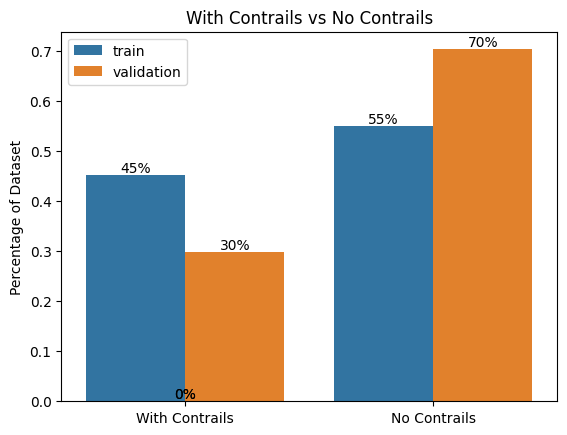

In [10]:
train_with_contrails = train_images_with_contrails / (train_images_with_contrails + train_images_without_contrails)
train_without_contrails = train_images_without_contrails / (train_images_with_contrails + train_images_without_contrails)
validation_with_contrails = validation_images_with_contrails / (validation_images_with_contrails + validation_images_without_contrails)
validation_without_contrails = validation_images_without_contrails / (validation_images_with_contrails + validation_images_without_contrails)
data = pd.DataFrame({'Type': ['With Contrails', 'No Contrails', 'With Contrails', 'No Contrails'],
        'Data': [train_with_contrails, train_without_contrails, validation_with_contrails, validation_without_contrails],
        'Data Set': ['train', 'train', 'validation', 'validation']})

ax = sns.barplot(data=data, y='Data', x="Type", hue="Data Set", orient='v')

for p in ax.patches:
    ax.annotate(format(p.get_height() * 100, '.0f') + '%',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
    
ax.set_xlabel('')
ax.set_ylabel('Percentage of Dataset')
ax.set_title('With Contrails vs No Contrails')

plt.legend()
plt.show()

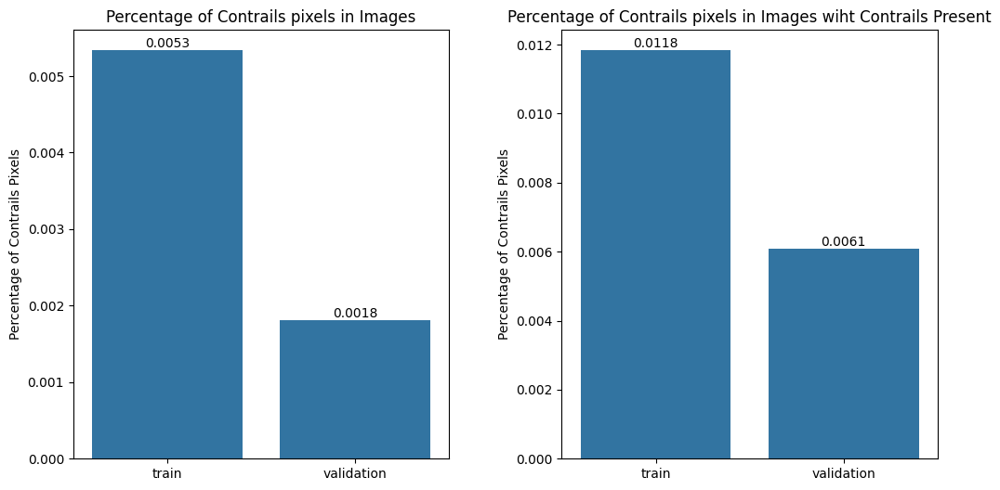

In [11]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
fig.subplots_adjust(wspace=0.3)
axes = axes.flatten()

train_with_contrails_pix = train_contrail_pixel_count / (train_contrail_pixel_count + train_non_contrail_pixel_count)
validation_with_contrails_pix = validation_contrail_pixel_count / (validation_contrail_pixel_count + validation_non_contrail_pixel_count)
data = pd.DataFrame({'Data': [train_with_contrails_pix, validation_with_contrails_pix],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[0])
for p in axes[0].patches:
    axes[0].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[0].set_xlabel('')
axes[0].set_ylabel('Percentage of Contrails Pixels')
axes[0].set_title('Percentage of Contrails pixels in Images')

train_with_contrails_pix_conly = train_contrail_pixel_count_conly / (train_contrail_pixel_count_conly + train_non_contrail_pixel_count_conly)
validation_with_contrails_pix_conly = validation_contrail_pixel_count_conly / (validation_contrail_pixel_count_conly + validation_non_contrail_pixel_count_conly)
data = pd.DataFrame({'Data': [train_with_contrails_pix_conly, validation_with_contrails_pix_conly],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[1])
for p in axes[1].patches:
    axes[1].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[1].set_xlabel('')
axes[1].set_ylabel('Percentage of Contrails Pixels')
axes[1].set_title('Percentage of Contrails pixels in Images wiht Contrails Present')

plt.show()

In [12]:
def show_band_images(idx: str, parrent_folder: str, band: str):
    data = get_band_images(idx, parrent_folder, band)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_images(idx: str, parrent_folder: str):
    data = get_ash_color_images(idx, parrent_folder)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_frame(idx: str, parrent_folder: str, frame: int):
    data = get_ash_color_images(idx, parrent_folder)
    plt.imshow(data[:,:,:,frame])
    plt.show()
    
def show_mask_image(idx: str, parrent_folder: str):
    plt.imshow(get_mask_image(idx, parrent_folder))
    plt.show()

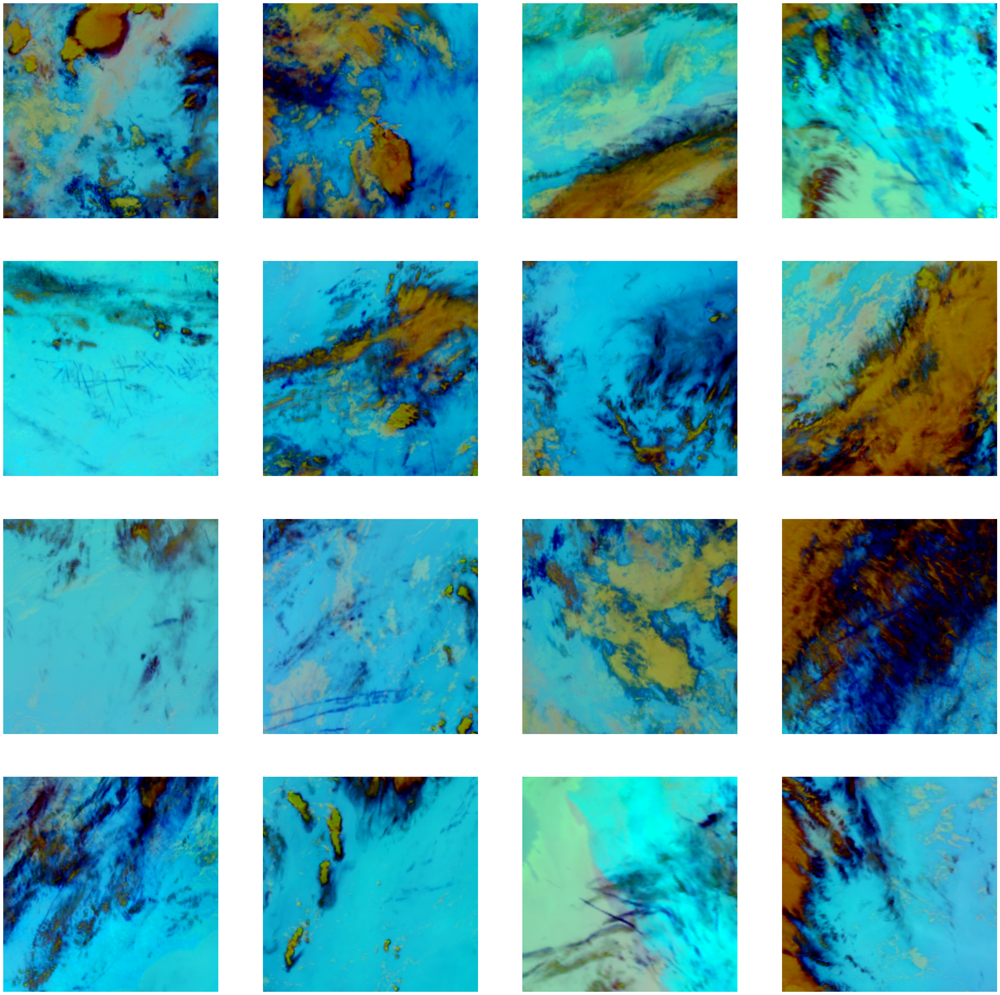

In [13]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(40, 40))
axes = axes.flatten()

for i in range(len(axes)):
    images = get_ash_color_images(str(df_train_idx.iloc[730 + i]['idx']), 'train')
    axes[i].imshow(images[:,:,:,4])
    axes[i].axis('off')

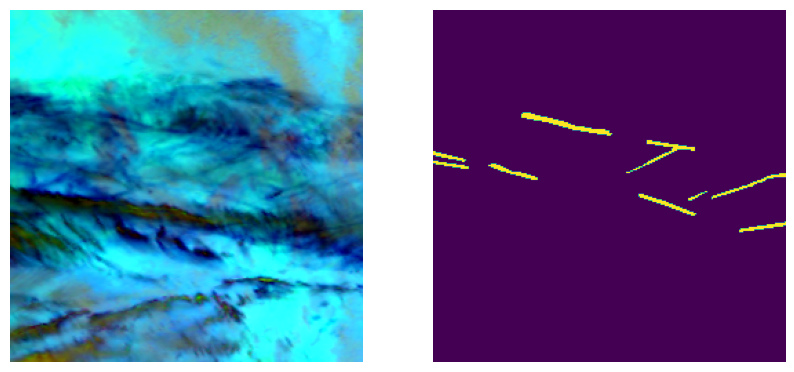

In [14]:
images = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
axes = axes.flatten()

axes[0].imshow(images[:,:,:,4])
axes[0].axis('off')
axes[1].imshow(get_mask_image(str(df_train_idx.iloc[683]['idx']), 'train'))
axes[1].axis('off')

plt.show()

# Model

In [15]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [16]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)

        self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = nn.functional.pad(x1, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])
        
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # Define your layers
        self.inc = DoubleConv(24, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        self.down4 = Down(512, 512)
        self.up1 = Up(1024, 256)
        self.up2 = Up(512, 128)
        self.up3 = Up(256, 64)
        self.up4 = Up(128, 64)
        self.outc = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        # Forward pass through the layers
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.outc(x)
        return x

In [17]:
summary(UNet().to(device), input_size=(24, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]          13,888
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,928
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
        DoubleConv-7         [-1, 64, 256, 256]               0
         MaxPool2d-8         [-1, 64, 128, 128]               0
            Conv2d-9        [-1, 128, 128, 128]          73,856
      BatchNorm2d-10        [-1, 128, 128, 128]             256
             ReLU-11        [-1, 128, 128, 128]               0
           Conv2d-12        [-1, 128, 128, 128]         147,584
      BatchNorm2d-13        [-1, 128, 128, 128]             256
             ReLU-14        [-1, 128, 1

# Trainer

In [18]:
class Dice(nn.Module):
    def __init__(self, use_sigmoid=True):
        super(Dice, self).__init__()
        self.sigmoid = nn.Sigmoid()
        self.use_sigmoid = use_sigmoid

    def forward(self, inputs, targets, smooth=1):
        if self.use_sigmoid:
            inputs = self.sigmoid(inputs)       
        
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()
        dice = (2.0 *intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
        return dice
    
dice = Dice()

In [19]:
class MyTrainer:
    def __init__(self, model, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            ):
  
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            for i, data in enumerate(tqdm(train_dataloader, desc=f"Epoch {e + 1}/{epochs} Training")):
            # for i, data in enumerate(train_dataloader):
                self.model.train()
                if i % 100 == 0:
                    print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
                    sub_batch_losses.clear()
                # Every data instance is an input + label pair
                images, mask = data
                
                if torch.cuda.is_available():
                    images = images.cuda()
                    mask = mask.cuda()

                # Zero your gradients for every batch!
                self.optimizer.zero_grad()
                # Make predictions for this batch
                outputs = self.model(images)
                # Compute the loss and its gradients
                loss = self.loss_fn(outputs, mask)
                loss.backward()
                # Adjust learning weights
                self.optimizer.step()

                # Saves data
                self.batch_losses.append(loss.item())
                batch_losses.append(loss)
                sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "checkpoints/" + type(self.model).__name__ + "_model_checkpoint_e" + str(e) + ".pt")
                # torch.save(self.model.state_dict(), "model_checkpoint_e" + str(e) + ".pt")
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(tqdm(test_dataloader, desc=f"Epoch {e + 1}/{epochs} Validation")):
                    # for i, data in enumerate(test_dataloader):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        loss = self.loss_fn(output, mask)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

# Dataset

In [20]:
class ContrailsAshDataset(torch.utils.data.Dataset):
    def __init__(self, parrent_folder: str):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming/{parrent_folder}')})
        self.parrent_folder: str = parrent_folder

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: str = str(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(image_id, self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        mask = torch.tensor(get_mask_image(image_id, self.parrent_folder)).to(torch.float32).permute(2, 0, 1)
        return images, mask

In [21]:
dataset_train = ContrailsAshDataset('train')
dataset_validation = ContrailsAshDataset('validation')

data_loader_train = DataLoader(dataset_train, batch_size=16, shuffle=True, num_workers=2)
data_loader_validation = DataLoader(dataset_validation, batch_size=16, shuffle=True, num_workers=2)

# Train

In [22]:
train = True

In [23]:
if train:
    model = UNet()
    model.to(device)

    criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100))
    optimizer = optim.Adam(model.parameters(), lr=0.01)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.70)

    num_epochs = 11

    trainer = MyTrainer(model, optimizer, criterion, lr_scheduler)
    trainer.fit(data_loader_train, data_loader_validation, epochs=num_epochs)
# else:
#     model = UNet()
#     model.load_state_dict(torch.load('/kaggle/input/contrails-unet-pretrained/unet.pt'))
#     model.eval()
#     model.to(device)

New learning rate: [0.01]


Epoch 1/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 0 batch: 0/1284 loss: nan


Epoch 1/11 Training:   8%|█▍                 | 101/1284 [00:21<04:07,  4.78it/s]

epotch: 0 batch: 100/1284 loss: 0.9611694812774658


Epoch 1/11 Training:  16%|██▉                | 201/1284 [00:42<03:49,  4.73it/s]

epotch: 0 batch: 200/1284 loss: 0.7420733571052551


Epoch 1/11 Training:  23%|████▍              | 301/1284 [01:03<03:29,  4.68it/s]

epotch: 0 batch: 300/1284 loss: 0.5877525806427002


Epoch 1/11 Training:  31%|█████▉             | 400/1284 [01:24<03:09,  4.65it/s]

epotch: 0 batch: 400/1284 loss: 0.6003521084785461


Epoch 1/11 Training:  39%|███████▍           | 500/1284 [01:46<02:48,  4.66it/s]

epotch: 0 batch: 500/1284 loss: 0.5574442148208618


Epoch 1/11 Training:  47%|████████▉          | 600/1284 [02:07<02:27,  4.64it/s]

epotch: 0 batch: 600/1284 loss: 0.5188459157943726


Epoch 1/11 Training:  55%|██████████▎        | 700/1284 [02:29<02:05,  4.64it/s]

epotch: 0 batch: 700/1284 loss: 0.5118057131767273


Epoch 1/11 Training:  62%|███████████▊       | 800/1284 [02:51<01:44,  4.65it/s]

epotch: 0 batch: 800/1284 loss: 0.4820171296596527


Epoch 1/11 Training:  70%|█████████████▎     | 900/1284 [03:12<01:22,  4.65it/s]

epotch: 0 batch: 900/1284 loss: 0.48158904910087585


Epoch 1/11 Training:  78%|██████████████    | 1000/1284 [03:34<01:01,  4.61it/s]

epotch: 0 batch: 1000/1284 loss: 0.4677993059158325


Epoch 1/11 Training:  86%|███████████████▍  | 1100/1284 [03:55<00:39,  4.68it/s]

epotch: 0 batch: 1100/1284 loss: 0.4651741087436676


Epoch 1/11 Training:  93%|████████████████▊ | 1200/1284 [04:17<00:18,  4.66it/s]

epotch: 0 batch: 1200/1284 loss: 0.42547714710235596


Epoch 1/11 Training: 100%|██████████████████| 1284/1284 [04:35<00:00,  4.66it/s]


Train Epoch: 0 Average Loss: 0.560290


Epoch 1/11 Validation: 100%|██████████████████| 116/116 [00:19<00:00,  5.86it/s]


Validation loss after 1 epochs was 0.2957
New learning rate: [0.006999999999999999]


Epoch 2/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 1 batch: 0/1284 loss: nan


Epoch 2/11 Training:   8%|█▍                 | 101/1284 [00:21<04:14,  4.64it/s]

epotch: 1 batch: 100/1284 loss: 0.4120261073112488


Epoch 2/11 Training:  16%|██▉                | 200/1284 [00:43<03:51,  4.67it/s]

epotch: 1 batch: 200/1284 loss: 0.40926170349121094


Epoch 2/11 Training:  23%|████▍              | 300/1284 [01:04<03:32,  4.63it/s]

epotch: 1 batch: 300/1284 loss: 0.42680370807647705


Epoch 2/11 Training:  31%|█████▉             | 401/1284 [01:26<03:08,  4.68it/s]

epotch: 1 batch: 400/1284 loss: 0.41460609436035156


Epoch 2/11 Training:  39%|███████▍           | 500/1284 [01:47<02:47,  4.68it/s]

epotch: 1 batch: 500/1284 loss: 0.41235607862472534


Epoch 2/11 Training:  47%|████████▉          | 600/1284 [02:08<02:25,  4.71it/s]

epotch: 1 batch: 600/1284 loss: 0.40260642766952515


Epoch 2/11 Training:  55%|██████████▎        | 700/1284 [02:30<02:04,  4.68it/s]

epotch: 1 batch: 700/1284 loss: 0.40802133083343506


Epoch 2/11 Training:  62%|███████████▊       | 800/1284 [02:51<01:43,  4.67it/s]

epotch: 1 batch: 800/1284 loss: 0.39659354090690613


Epoch 2/11 Training:  70%|█████████████▎     | 900/1284 [03:13<01:24,  4.57it/s]

epotch: 1 batch: 900/1284 loss: 0.3841548562049866


Epoch 2/11 Training:  78%|██████████████    | 1000/1284 [03:35<01:03,  4.46it/s]

epotch: 1 batch: 1000/1284 loss: 0.3711968660354614


Epoch 2/11 Training:  86%|███████████████▍  | 1100/1284 [03:58<00:43,  4.23it/s]

epotch: 1 batch: 1100/1284 loss: 0.36700600385665894


Epoch 2/11 Training:  93%|████████████████▊ | 1200/1284 [04:21<00:19,  4.27it/s]

epotch: 1 batch: 1200/1284 loss: 0.3482969403266907


Epoch 2/11 Training: 100%|██████████████████| 1284/1284 [04:41<00:00,  4.56it/s]


Train Epoch: 1 Average Loss: 0.391164


Epoch 2/11 Validation: 100%|██████████████████| 116/116 [00:14<00:00,  8.13it/s]


Validation loss after 2 epochs was 0.2484
New learning rate: [0.004899999999999999]


Epoch 3/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 2 batch: 0/1284 loss: nan


Epoch 3/11 Training:   8%|█▍                 | 100/1284 [00:21<04:11,  4.71it/s]

epotch: 2 batch: 100/1284 loss: 0.3366650342941284


Epoch 3/11 Training:  16%|██▉                | 200/1284 [00:43<03:51,  4.68it/s]

epotch: 2 batch: 200/1284 loss: 0.30500513315200806


Epoch 3/11 Training:  23%|████▍              | 300/1284 [01:04<03:30,  4.68it/s]

epotch: 2 batch: 300/1284 loss: 0.30550602078437805


Epoch 3/11 Training:  31%|█████▉             | 400/1284 [01:26<03:08,  4.68it/s]

epotch: 2 batch: 400/1284 loss: 0.31377214193344116


Epoch 3/11 Training:  39%|███████▍           | 500/1284 [01:47<02:49,  4.64it/s]

epotch: 2 batch: 500/1284 loss: 0.30209973454475403


Epoch 3/11 Training:  47%|████████▉          | 601/1284 [02:09<02:26,  4.68it/s]

epotch: 2 batch: 600/1284 loss: 0.27761414647102356


Epoch 3/11 Training:  55%|██████████▎        | 700/1284 [02:30<02:04,  4.68it/s]

epotch: 2 batch: 700/1284 loss: 0.2727370858192444


Epoch 3/11 Training:  62%|███████████▊       | 800/1284 [02:51<01:43,  4.70it/s]

epotch: 2 batch: 800/1284 loss: 0.27176952362060547


Epoch 3/11 Training:  70%|█████████████▎     | 900/1284 [03:13<01:21,  4.68it/s]

epotch: 2 batch: 900/1284 loss: 0.27001240849494934


Epoch 3/11 Training:  78%|██████████████    | 1000/1284 [03:34<01:00,  4.67it/s]

epotch: 2 batch: 1000/1284 loss: 0.28762200474739075


Epoch 3/11 Training:  86%|███████████████▍  | 1100/1284 [03:55<00:39,  4.65it/s]

epotch: 2 batch: 1100/1284 loss: 0.2687481641769409


Epoch 3/11 Training:  93%|████████████████▊ | 1200/1284 [04:17<00:17,  4.67it/s]

epotch: 2 batch: 1200/1284 loss: 0.27309972047805786


Epoch 3/11 Training: 100%|██████████████████| 1284/1284 [04:36<00:00,  4.65it/s]


Train Epoch: 2 Average Loss: 0.288273


Epoch 3/11 Validation: 100%|██████████████████| 116/116 [00:13<00:00,  8.80it/s]


Validation loss after 3 epochs was 0.2382
New learning rate: [0.003429999999999999]


Epoch 4/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 3 batch: 0/1284 loss: nan


Epoch 4/11 Training:   8%|█▍                 | 101/1284 [00:22<04:12,  4.69it/s]

epotch: 3 batch: 100/1284 loss: 0.22841507196426392


Epoch 4/11 Training:  16%|██▉                | 200/1284 [00:43<03:54,  4.62it/s]

epotch: 3 batch: 200/1284 loss: 0.24399146437644958


Epoch 4/11 Training:  23%|████▍              | 300/1284 [01:04<03:29,  4.69it/s]

epotch: 3 batch: 300/1284 loss: 0.24997390806674957


Epoch 4/11 Training:  31%|█████▉             | 400/1284 [01:26<03:09,  4.66it/s]

epotch: 3 batch: 400/1284 loss: 0.23886638879776


Epoch 4/11 Training:  39%|███████▍           | 501/1284 [01:47<02:47,  4.67it/s]

epotch: 3 batch: 500/1284 loss: 0.24695198237895966


Epoch 4/11 Training:  47%|████████▉          | 600/1284 [02:09<02:27,  4.63it/s]

epotch: 3 batch: 600/1284 loss: 0.23452267050743103


Epoch 4/11 Training:  55%|██████████▎        | 700/1284 [02:30<02:07,  4.59it/s]

epotch: 3 batch: 700/1284 loss: 0.25061148405075073


Epoch 4/11 Training:  62%|███████████▊       | 800/1284 [02:52<01:45,  4.60it/s]

epotch: 3 batch: 800/1284 loss: 0.23746812343597412


Epoch 4/11 Training:  70%|█████████████▎     | 900/1284 [03:13<01:22,  4.65it/s]

epotch: 3 batch: 900/1284 loss: 0.2341986447572708


Epoch 4/11 Training:  78%|██████████████    | 1000/1284 [03:35<01:04,  4.37it/s]

epotch: 3 batch: 1000/1284 loss: 0.23222889006137848


Epoch 4/11 Training:  86%|███████████████▍  | 1100/1284 [03:57<00:42,  4.32it/s]

epotch: 3 batch: 1100/1284 loss: 0.21685275435447693


Epoch 4/11 Training:  93%|████████████████▊ | 1200/1284 [04:21<00:21,  3.96it/s]

epotch: 3 batch: 1200/1284 loss: 0.21620655059814453


Epoch 4/11 Training: 100%|██████████████████| 1284/1284 [04:42<00:00,  4.55it/s]


Train Epoch: 3 Average Loss: 0.234951


Epoch 4/11 Validation: 100%|██████████████████| 116/116 [00:16<00:00,  7.10it/s]


Validation loss after 4 epochs was 0.163
New learning rate: [0.002400999999999999]


Epoch 5/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 4 batch: 0/1284 loss: nan


Epoch 5/11 Training:   8%|█▍                 | 100/1284 [00:21<04:13,  4.68it/s]

epotch: 4 batch: 100/1284 loss: 0.21450240910053253


Epoch 5/11 Training:  16%|██▉                | 200/1284 [00:43<03:54,  4.63it/s]

epotch: 4 batch: 200/1284 loss: 0.19506698846817017


Epoch 5/11 Training:  23%|████▍              | 300/1284 [01:04<03:29,  4.69it/s]

epotch: 4 batch: 300/1284 loss: 0.21764999628067017


Epoch 5/11 Training:  31%|█████▉             | 400/1284 [01:26<03:09,  4.66it/s]

epotch: 4 batch: 400/1284 loss: 0.19609946012496948


Epoch 5/11 Training:  39%|███████▍           | 500/1284 [01:47<02:47,  4.68it/s]

epotch: 4 batch: 500/1284 loss: 0.1855204701423645


Epoch 5/11 Training:  47%|████████▉          | 600/1284 [02:09<02:26,  4.67it/s]

epotch: 4 batch: 600/1284 loss: 0.19520343840122223


Epoch 5/11 Training:  55%|██████████▎        | 700/1284 [02:30<02:05,  4.66it/s]

epotch: 4 batch: 700/1284 loss: 0.2185329794883728


Epoch 5/11 Training:  62%|███████████▊       | 800/1284 [02:51<01:43,  4.69it/s]

epotch: 4 batch: 800/1284 loss: 0.2061106115579605


Epoch 5/11 Training:  70%|█████████████▎     | 900/1284 [03:14<01:28,  4.33it/s]

epotch: 4 batch: 900/1284 loss: 0.1960674673318863


Epoch 5/11 Training:  78%|██████████████    | 1000/1284 [03:37<01:07,  4.24it/s]

epotch: 4 batch: 1000/1284 loss: 0.192935049533844


Epoch 5/11 Training:  86%|███████████████▍  | 1100/1284 [04:00<00:40,  4.55it/s]

epotch: 4 batch: 1100/1284 loss: 0.18653923273086548


Epoch 5/11 Training:  93%|████████████████▊ | 1200/1284 [04:23<00:20,  4.02it/s]

epotch: 4 batch: 1200/1284 loss: 0.19489267468452454


Epoch 5/11 Training: 100%|██████████████████| 1284/1284 [04:42<00:00,  4.55it/s]


Train Epoch: 4 Average Loss: 0.198511


Epoch 5/11 Validation: 100%|██████████████████| 116/116 [00:13<00:00,  8.85it/s]


Validation loss after 5 epochs was 0.1203
New learning rate: [0.0016806999999999992]


Epoch 6/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 5 batch: 0/1284 loss: nan


Epoch 6/11 Training:   8%|█▍                 | 100/1284 [00:21<04:13,  4.67it/s]

epotch: 5 batch: 100/1284 loss: 0.18795184791088104


Epoch 6/11 Training:  16%|██▉                | 200/1284 [00:43<03:51,  4.68it/s]

epotch: 5 batch: 200/1284 loss: 0.17844383418560028


Epoch 6/11 Training:  23%|████▍              | 300/1284 [01:04<03:29,  4.71it/s]

epotch: 5 batch: 300/1284 loss: 0.17621396481990814


Epoch 6/11 Training:  31%|█████▉             | 400/1284 [01:26<03:08,  4.68it/s]

epotch: 5 batch: 400/1284 loss: 0.17527888715267181


Epoch 6/11 Training:  39%|███████▍           | 500/1284 [01:47<02:49,  4.62it/s]

epotch: 5 batch: 500/1284 loss: 0.17072778940200806


Epoch 6/11 Training:  47%|████████▉          | 600/1284 [02:12<02:24,  4.72it/s]

epotch: 5 batch: 600/1284 loss: 0.16760273277759552


Epoch 6/11 Training:  55%|██████████▎        | 700/1284 [02:34<02:05,  4.66it/s]

epotch: 5 batch: 700/1284 loss: 0.17782096564769745


Epoch 6/11 Training:  62%|███████████▊       | 801/1284 [02:55<01:43,  4.68it/s]

epotch: 5 batch: 800/1284 loss: 0.17874431610107422


Epoch 6/11 Training:  70%|█████████████▎     | 900/1284 [03:16<01:22,  4.66it/s]

epotch: 5 batch: 900/1284 loss: 0.1653861105442047


Epoch 6/11 Training:  78%|██████████████    | 1000/1284 [03:38<01:01,  4.65it/s]

epotch: 5 batch: 1000/1284 loss: 0.1844729632139206


Epoch 6/11 Training:  86%|███████████████▍  | 1100/1284 [03:59<00:39,  4.63it/s]

epotch: 5 batch: 1100/1284 loss: 0.18626174330711365


Epoch 6/11 Training:  93%|████████████████▊ | 1200/1284 [04:21<00:18,  4.61it/s]

epotch: 5 batch: 1200/1284 loss: 0.17248576879501343


Epoch 6/11 Training: 100%|██████████████████| 1284/1284 [04:40<00:00,  4.58it/s]


Train Epoch: 5 Average Loss: 0.176142


Epoch 6/11 Validation: 100%|██████████████████| 116/116 [00:16<00:00,  7.17it/s]


Validation loss after 6 epochs was 0.1066
New learning rate: [0.0011764899999999994]


Epoch 7/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 6 batch: 0/1284 loss: nan


Epoch 7/11 Training:   8%|█▍                 | 101/1284 [00:22<04:12,  4.68it/s]

epotch: 6 batch: 100/1284 loss: 0.16119372844696045


Epoch 7/11 Training:  16%|██▉                | 200/1284 [00:43<03:51,  4.67it/s]

epotch: 6 batch: 200/1284 loss: 0.158879354596138


Epoch 7/11 Training:  23%|████▍              | 300/1284 [01:04<03:29,  4.70it/s]

epotch: 6 batch: 300/1284 loss: 0.16200877726078033


Epoch 7/11 Training:  31%|█████▉             | 400/1284 [01:26<03:09,  4.66it/s]

epotch: 6 batch: 400/1284 loss: 0.1546872854232788


Epoch 7/11 Training:  39%|███████▍           | 500/1284 [01:47<02:47,  4.69it/s]

epotch: 6 batch: 500/1284 loss: 0.1468188315629959


Epoch 7/11 Training:  47%|████████▉          | 600/1284 [02:08<02:26,  4.67it/s]

epotch: 6 batch: 600/1284 loss: 0.15923026204109192


Epoch 7/11 Training:  55%|██████████▎        | 700/1284 [02:30<02:04,  4.68it/s]

epotch: 6 batch: 700/1284 loss: 0.1508265733718872


Epoch 7/11 Training:  62%|███████████▊       | 800/1284 [02:51<01:43,  4.67it/s]

epotch: 6 batch: 800/1284 loss: 0.15653471648693085


Epoch 7/11 Training:  70%|█████████████▎     | 900/1284 [03:12<01:21,  4.72it/s]

epotch: 6 batch: 900/1284 loss: 0.15805290639400482


Epoch 7/11 Training:  78%|██████████████    | 1001/1284 [03:34<01:00,  4.65it/s]

epotch: 6 batch: 1000/1284 loss: 0.16940857470035553


Epoch 7/11 Training:  86%|███████████████▍  | 1100/1284 [03:56<00:41,  4.42it/s]

epotch: 6 batch: 1100/1284 loss: 0.1563061773777008


Epoch 7/11 Training:  93%|████████████████▊ | 1200/1284 [04:20<00:19,  4.34it/s]

epotch: 6 batch: 1200/1284 loss: 0.16564983129501343


Epoch 7/11 Training: 100%|██████████████████| 1284/1284 [04:40<00:00,  4.57it/s]


Train Epoch: 6 Average Loss: 0.157636


Epoch 7/11 Validation: 100%|██████████████████| 116/116 [00:16<00:00,  7.12it/s]


Validation loss after 7 epochs was 0.0971
New learning rate: [0.0008235429999999996]


Epoch 8/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 7 batch: 0/1284 loss: nan


Epoch 8/11 Training:   8%|█▍                 | 100/1284 [00:21<04:11,  4.71it/s]

epotch: 7 batch: 100/1284 loss: 0.15826372802257538


Epoch 8/11 Training:  16%|██▉                | 201/1284 [00:43<03:49,  4.71it/s]

epotch: 7 batch: 200/1284 loss: 0.14806747436523438


Epoch 8/11 Training:  23%|████▍              | 300/1284 [01:04<03:29,  4.70it/s]

epotch: 7 batch: 300/1284 loss: 0.15314881503582


Epoch 8/11 Training:  31%|█████▉             | 400/1284 [01:25<03:09,  4.67it/s]

epotch: 7 batch: 400/1284 loss: 0.13779966533184052


Epoch 8/11 Training:  39%|███████▍           | 500/1284 [01:47<02:47,  4.69it/s]

epotch: 7 batch: 500/1284 loss: 0.14504815638065338


Epoch 8/11 Training:  47%|████████▉          | 600/1284 [02:08<02:26,  4.66it/s]

epotch: 7 batch: 600/1284 loss: 0.14152653515338898


Epoch 8/11 Training:  55%|██████████▎        | 700/1284 [02:29<02:05,  4.65it/s]

epotch: 7 batch: 700/1284 loss: 0.15447872877120972


Epoch 8/11 Training:  62%|███████████▊       | 800/1284 [02:51<01:44,  4.64it/s]

epotch: 7 batch: 800/1284 loss: 0.13870353996753693


Epoch 8/11 Training:  70%|█████████████▎     | 900/1284 [03:12<01:22,  4.68it/s]

epotch: 7 batch: 900/1284 loss: 0.13795846700668335


Epoch 8/11 Training:  78%|██████████████    | 1000/1284 [03:34<01:03,  4.46it/s]

epotch: 7 batch: 1000/1284 loss: 0.145584836602211


Epoch 8/11 Training:  86%|███████████████▍  | 1100/1284 [03:57<00:40,  4.51it/s]

epotch: 7 batch: 1100/1284 loss: 0.14679886400699615


Epoch 8/11 Training:  93%|████████████████▊ | 1200/1284 [04:19<00:18,  4.62it/s]

epotch: 7 batch: 1200/1284 loss: 0.1389756053686142


Epoch 8/11 Training: 100%|██████████████████| 1284/1284 [04:38<00:00,  4.61it/s]


Train Epoch: 7 Average Loss: 0.145944


Epoch 8/11 Validation: 100%|██████████████████| 116/116 [00:13<00:00,  8.48it/s]


Validation loss after 8 epochs was 0.0942
New learning rate: [0.0005764800999999997]


Epoch 9/11 Training:   0%|                             | 0/1284 [00:00<?, ?it/s]

epotch: 8 batch: 0/1284 loss: nan


Epoch 9/11 Training:   8%|█▍                 | 100/1284 [00:21<04:13,  4.68it/s]

epotch: 8 batch: 100/1284 loss: 0.14111164212226868


Epoch 9/11 Training:  16%|██▉                | 200/1284 [00:43<03:51,  4.69it/s]

epotch: 8 batch: 200/1284 loss: 0.13035984337329865


Epoch 9/11 Training:  23%|████▍              | 300/1284 [01:04<03:29,  4.69it/s]

epotch: 8 batch: 300/1284 loss: 0.13488808274269104


Epoch 9/11 Training:  31%|█████▉             | 400/1284 [01:25<03:09,  4.67it/s]

epotch: 8 batch: 400/1284 loss: 0.12460191547870636


Epoch 9/11 Training:  39%|███████▍           | 500/1284 [01:47<02:49,  4.62it/s]

epotch: 8 batch: 500/1284 loss: 0.12992791831493378


Epoch 9/11 Training:  47%|████████▉          | 600/1284 [02:08<02:26,  4.68it/s]

epotch: 8 batch: 600/1284 loss: 0.1370619684457779


Epoch 9/11 Training:  55%|██████████▎        | 700/1284 [02:30<02:05,  4.67it/s]

epotch: 8 batch: 700/1284 loss: 0.14195659756660461


Epoch 9/11 Training:  62%|███████████▊       | 800/1284 [02:51<01:43,  4.69it/s]

epotch: 8 batch: 800/1284 loss: 0.1368822604417801


Epoch 9/11 Training:  70%|█████████████▎     | 900/1284 [03:13<01:22,  4.64it/s]

epotch: 8 batch: 900/1284 loss: 0.1391351968050003


Epoch 9/11 Training:  78%|██████████████    | 1000/1284 [03:34<01:00,  4.68it/s]

epotch: 8 batch: 1000/1284 loss: 0.1365853250026703


Epoch 9/11 Training:  86%|███████████████▍  | 1100/1284 [03:56<00:39,  4.65it/s]

epotch: 8 batch: 1100/1284 loss: 0.1296406388282776


Epoch 9/11 Training:  93%|████████████████▊ | 1200/1284 [04:17<00:17,  4.67it/s]

epotch: 8 batch: 1200/1284 loss: 0.13348311185836792


Epoch 9/11 Training: 100%|██████████████████| 1284/1284 [04:35<00:00,  4.66it/s]


Train Epoch: 8 Average Loss: 0.135189


Epoch 9/11 Validation: 100%|██████████████████| 116/116 [00:16<00:00,  7.06it/s]


Validation loss after 9 epochs was 0.0925
New learning rate: [0.00040353606999999974]


Epoch 10/11 Training:   0%|                            | 0/1284 [00:00<?, ?it/s]

epotch: 9 batch: 0/1284 loss: nan


Epoch 10/11 Training:   8%|█▍                | 100/1284 [00:21<04:14,  4.65it/s]

epotch: 9 batch: 100/1284 loss: 0.1259305328130722


Epoch 10/11 Training:  16%|██▊               | 200/1284 [00:43<03:51,  4.68it/s]

epotch: 9 batch: 200/1284 loss: 0.1271521896123886


Epoch 10/11 Training:  23%|████▏             | 300/1284 [01:04<03:30,  4.67it/s]

epotch: 9 batch: 300/1284 loss: 0.1264733523130417


Epoch 10/11 Training:  31%|█████▌            | 400/1284 [01:26<03:09,  4.66it/s]

epotch: 9 batch: 400/1284 loss: 0.12499254196882248


Epoch 10/11 Training:  39%|███████           | 500/1284 [01:47<02:47,  4.68it/s]

epotch: 9 batch: 500/1284 loss: 0.12655659019947052


Epoch 10/11 Training:  47%|████████▍         | 600/1284 [02:09<02:26,  4.65it/s]

epotch: 9 batch: 600/1284 loss: 0.13360154628753662


Epoch 10/11 Training:  55%|█████████▊        | 700/1284 [02:30<02:05,  4.67it/s]

epotch: 9 batch: 700/1284 loss: 0.12483565509319305


Epoch 10/11 Training:  62%|███████████▏      | 800/1284 [02:51<01:43,  4.68it/s]

epotch: 9 batch: 800/1284 loss: 0.12970612943172455


Epoch 10/11 Training:  70%|████████████▌     | 900/1284 [03:13<01:22,  4.67it/s]

epotch: 9 batch: 900/1284 loss: 0.13626284897327423


Epoch 10/11 Training:  78%|█████████████▏   | 1000/1284 [03:34<01:01,  4.65it/s]

epotch: 9 batch: 1000/1284 loss: 0.12158404290676117


Epoch 10/11 Training:  86%|██████████████▌  | 1100/1284 [03:56<00:39,  4.63it/s]

epotch: 9 batch: 1100/1284 loss: 0.12682989239692688


Epoch 10/11 Training:  93%|███████████████▉ | 1200/1284 [04:17<00:18,  4.50it/s]

epotch: 9 batch: 1200/1284 loss: 0.12747211754322052


Epoch 10/11 Training: 100%|█████████████████| 1284/1284 [04:36<00:00,  4.65it/s]


Train Epoch: 9 Average Loss: 0.127797


Epoch 10/11 Validation: 100%|█████████████████| 116/116 [00:14<00:00,  8.23it/s]


Validation loss after 10 epochs was 0.09
New learning rate: [0.0002824752489999998]


Epoch 11/11 Training:   0%|                            | 0/1284 [00:00<?, ?it/s]

epotch: 10 batch: 0/1284 loss: nan


Epoch 11/11 Training:   8%|█▍                | 100/1284 [00:23<04:12,  4.68it/s]

epotch: 10 batch: 100/1284 loss: 0.12423717230558395


Epoch 11/11 Training:  16%|██▊               | 200/1284 [00:44<03:51,  4.68it/s]

epotch: 10 batch: 200/1284 loss: 0.11596308648586273


Epoch 11/11 Training:  23%|████▏             | 300/1284 [01:05<03:29,  4.70it/s]

epotch: 10 batch: 300/1284 loss: 0.1267683207988739


Epoch 11/11 Training:  31%|█████▌            | 400/1284 [01:27<03:08,  4.70it/s]

epotch: 10 batch: 400/1284 loss: 0.11705021560192108


Epoch 11/11 Training:  39%|███████           | 500/1284 [01:48<02:47,  4.67it/s]

epotch: 10 batch: 500/1284 loss: 0.1226092129945755


Epoch 11/11 Training:  47%|████████▍         | 600/1284 [02:09<02:26,  4.68it/s]

epotch: 10 batch: 600/1284 loss: 0.12364114820957184


Epoch 11/11 Training:  55%|█████████▊        | 700/1284 [02:31<02:05,  4.67it/s]

epotch: 10 batch: 700/1284 loss: 0.12830473482608795


Epoch 11/11 Training:  62%|███████████▏      | 800/1284 [02:52<01:45,  4.59it/s]

epotch: 10 batch: 800/1284 loss: 0.12296737730503082


Epoch 11/11 Training:  70%|████████████▌     | 900/1284 [03:14<01:22,  4.65it/s]

epotch: 10 batch: 900/1284 loss: 0.1235358789563179


Epoch 11/11 Training:  78%|█████████████▏   | 1000/1284 [03:35<01:00,  4.69it/s]

epotch: 10 batch: 1000/1284 loss: 0.11874415725469589


Epoch 11/11 Training:  86%|██████████████▌  | 1100/1284 [03:57<00:42,  4.36it/s]

epotch: 10 batch: 1100/1284 loss: 0.12513861060142517


Epoch 11/11 Training:  93%|███████████████▉ | 1200/1284 [04:20<00:19,  4.41it/s]

epotch: 10 batch: 1200/1284 loss: 0.12522420287132263


Epoch 11/11 Training: 100%|█████████████████| 1284/1284 [04:38<00:00,  4.61it/s]


Train Epoch: 10 Average Loss: 0.123760


Epoch 11/11 Validation: 100%|█████████████████| 116/116 [00:16<00:00,  7.05it/s]


Validation loss after 11 epochs was 0.0937


# Training Overview

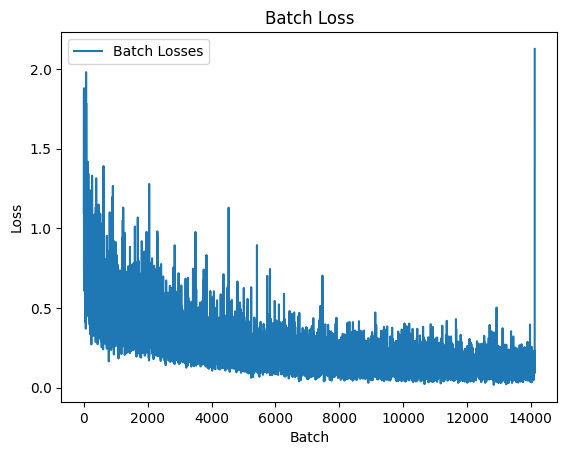

In [24]:
if train:
    df_data = pd.DataFrame({'Batch Losses': trainer.batch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Batch')
    plt.ylabel('Loss')
    plt.title('Batch Loss')
    plt.show()

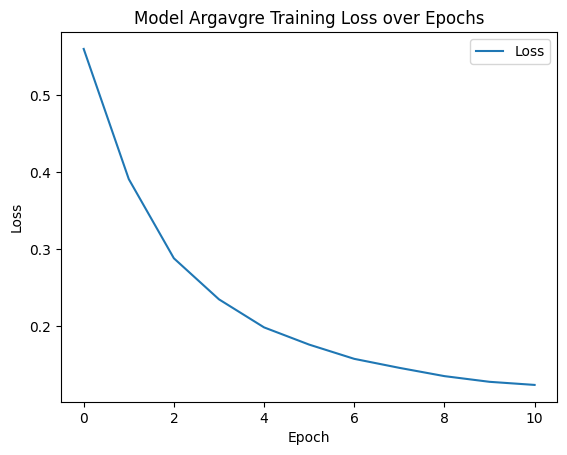

In [25]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.epoch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Argavgre Training Loss over Epochs')
    plt.show()

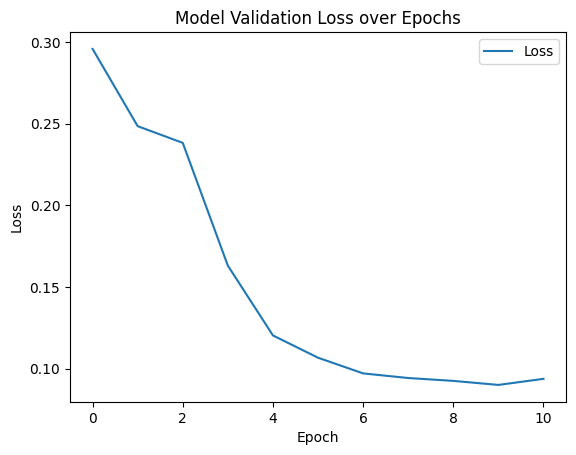

In [26]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.validation_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Validation Loss over Epochs')
    plt.show()

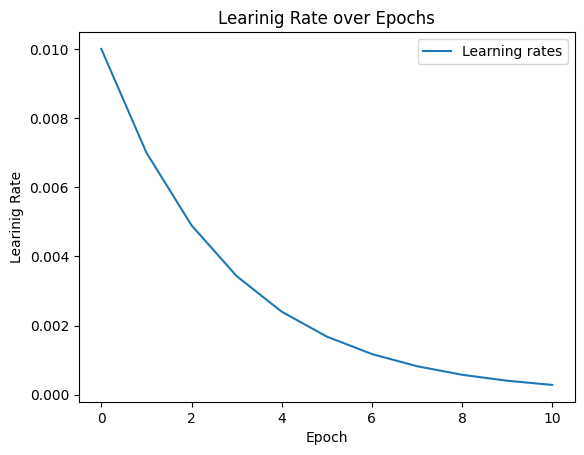

In [27]:
if train:
    df_data = pd.DataFrame({'Learning rates': trainer.learning_rates})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Learinig Rate')
    plt.title('Learinig Rate over Epochs')
    plt.show()

# Find Optimal Threshold

In [28]:
class DiceThresholdTester:
    
    def __init__(self, model: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

In [29]:
dice_threshold_tester = DiceThresholdTester(model, data_loader_validation)
dice_threshold_tester.precalculate_prediction()

In [30]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.97 with dice: 0.5426947110738903


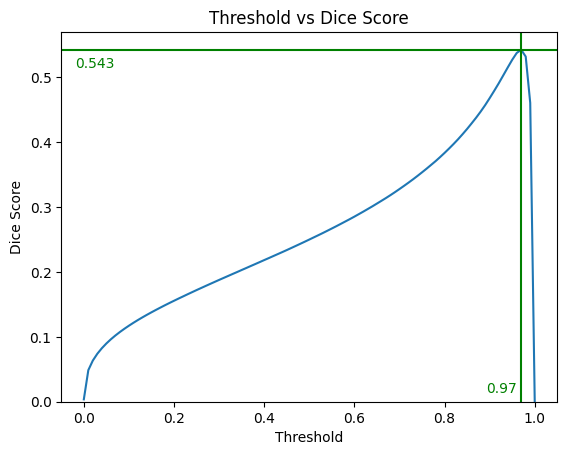

In [31]:
sns.lineplot(data=df_threshold_data, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

# Preview Models Predictions on Validation

Saved plot: plot_output PureBaseline/batch_1_img_1.png


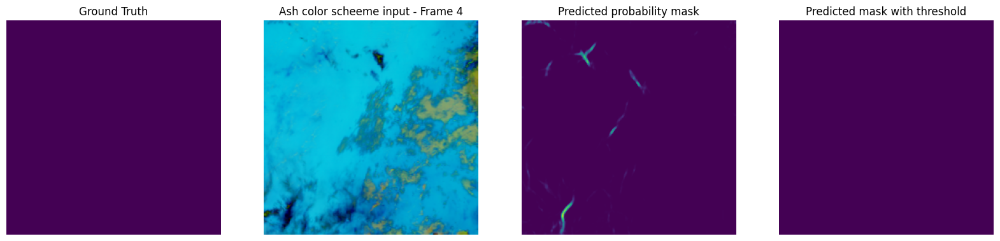

Saved plot: plot_output PureBaseline/batch_1_img_2.png


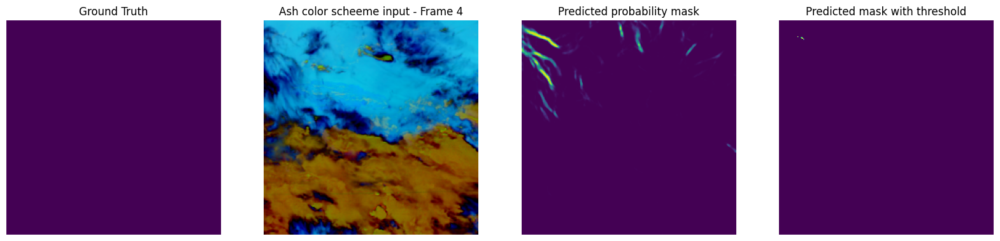

Saved plot: plot_output PureBaseline/batch_1_img_3.png


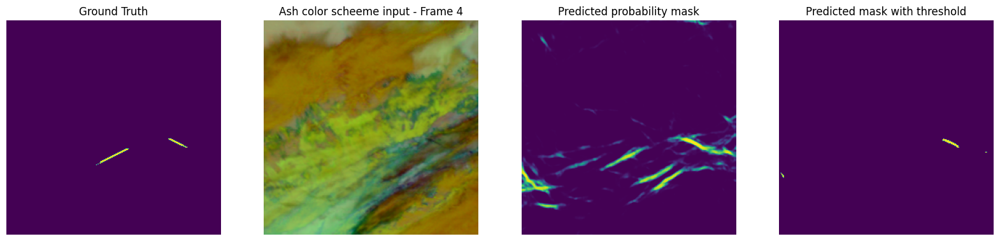

Saved plot: plot_output PureBaseline/batch_1_img_4.png


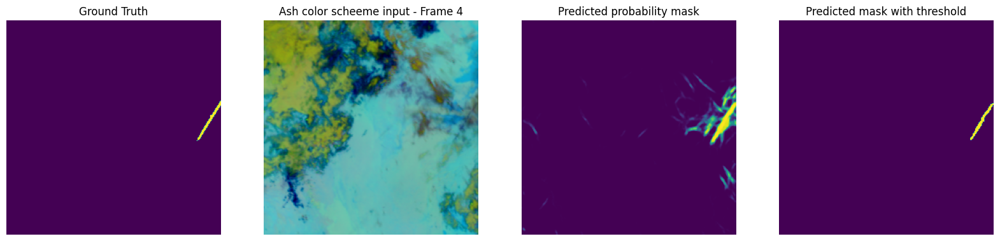

Saved plot: plot_output PureBaseline/batch_1_img_5.png


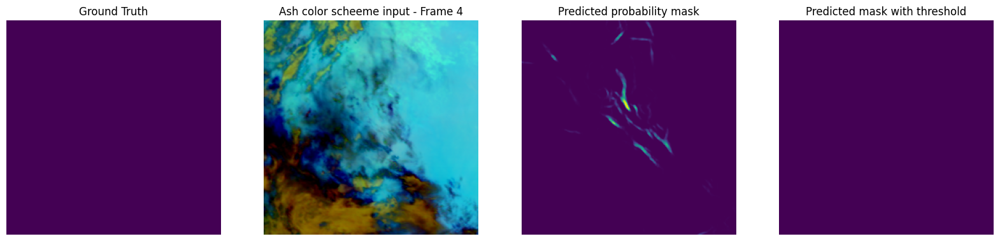

Saved plot: plot_output PureBaseline/batch_1_img_6.png


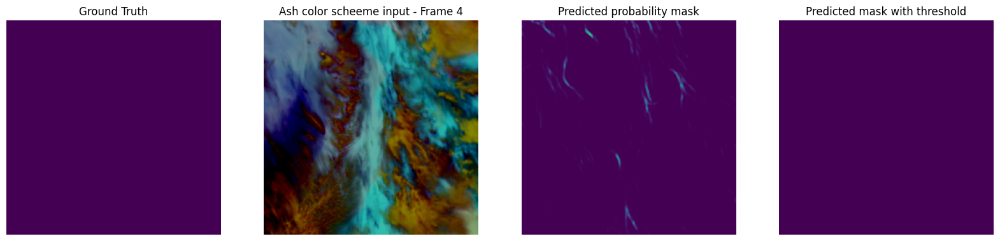

Saved plot: plot_output PureBaseline/batch_1_img_7.png


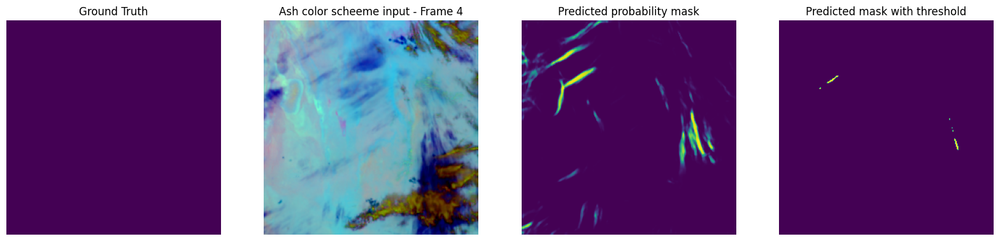

Saved plot: plot_output PureBaseline/batch_1_img_8.png


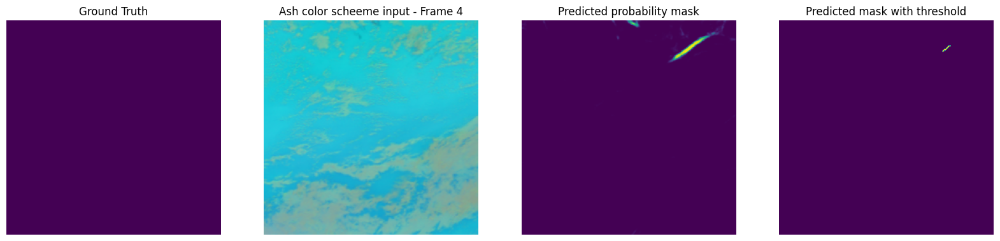

Saved plot: plot_output PureBaseline/batch_1_img_9.png


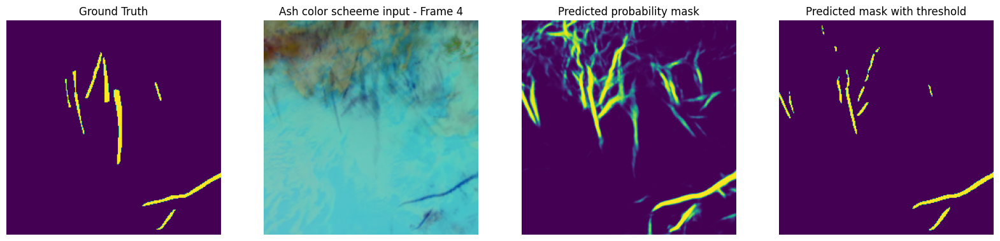

Saved plot: plot_output PureBaseline/batch_1_img_10.png


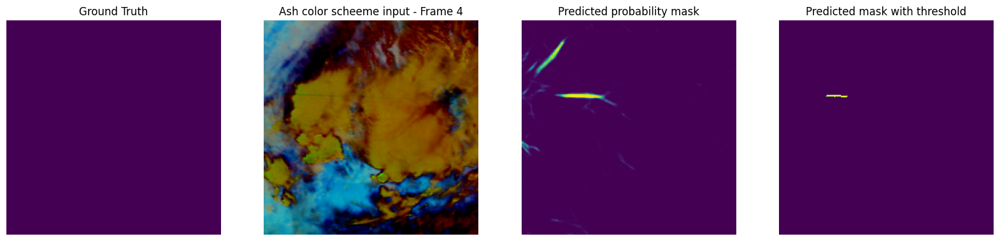

Saved plot: plot_output PureBaseline/batch_1_img_11.png


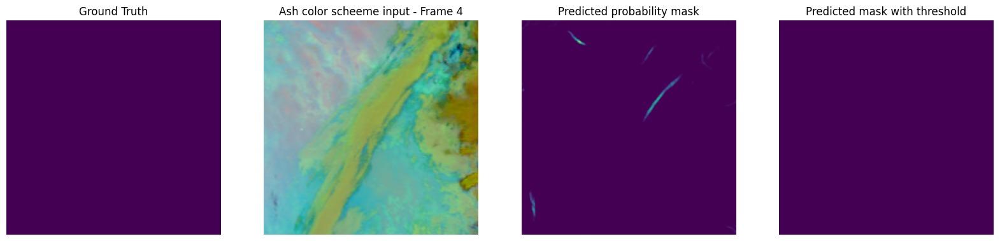

Saved plot: plot_output PureBaseline/batch_1_img_12.png


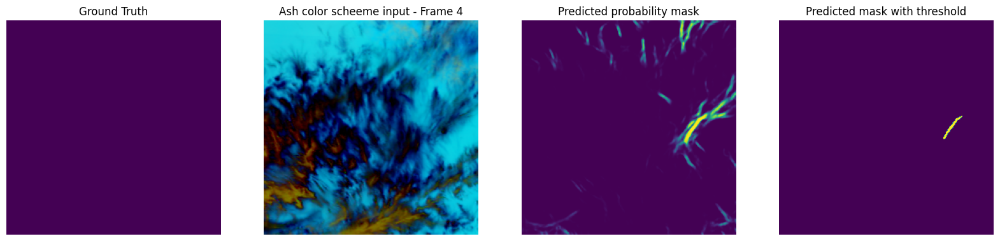

Saved plot: plot_output PureBaseline/batch_1_img_13.png


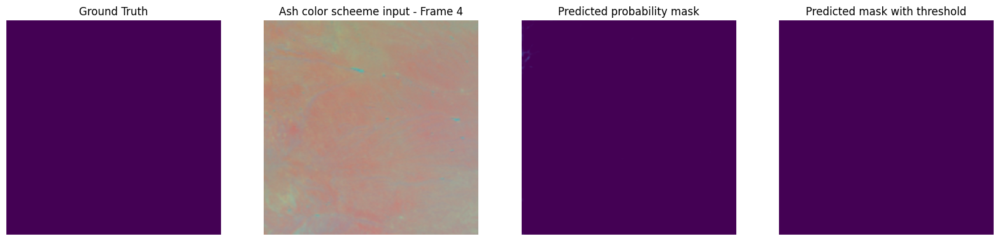

Saved plot: plot_output PureBaseline/batch_1_img_14.png


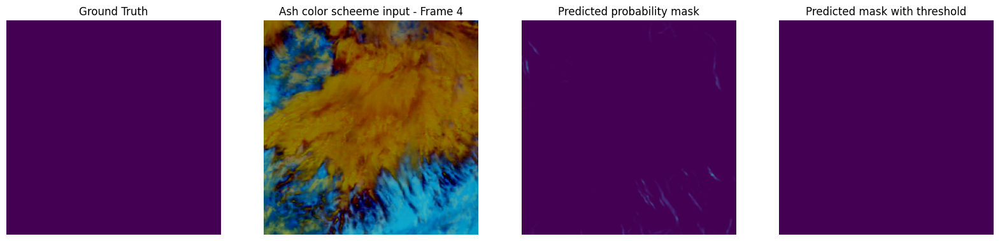

Saved plot: plot_output PureBaseline/batch_1_img_15.png


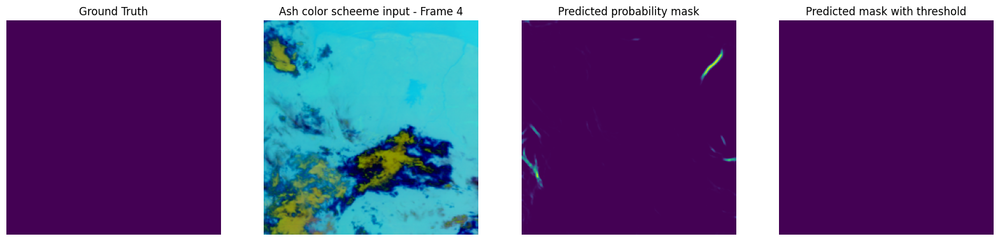

Saved plot: plot_output PureBaseline/batch_1_img_16.png


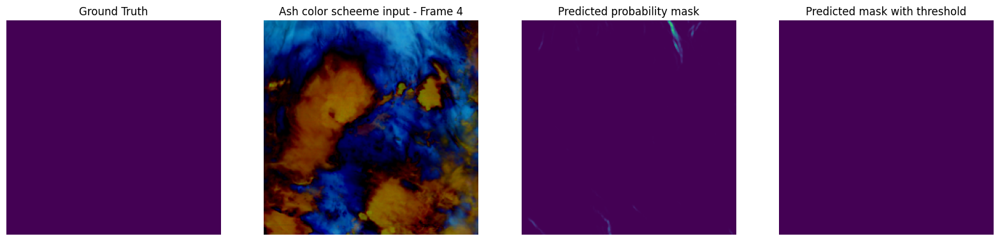

Saved plot: plot_output PureBaseline/batch_2_img_1.png


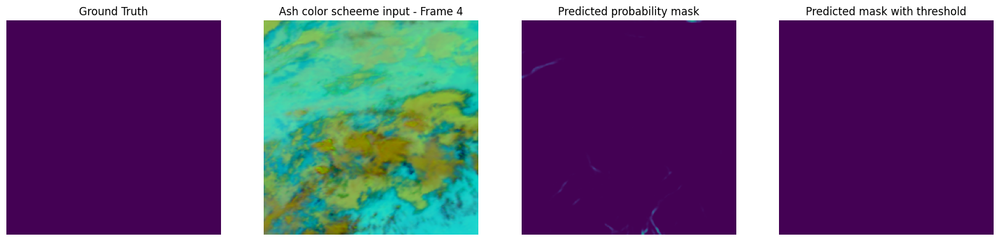

Saved plot: plot_output PureBaseline/batch_2_img_2.png


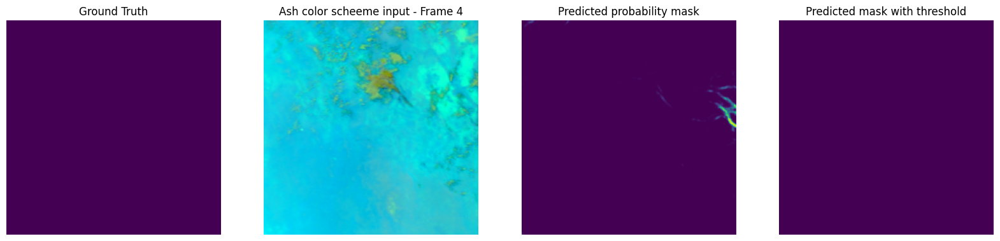

Saved plot: plot_output PureBaseline/batch_2_img_3.png


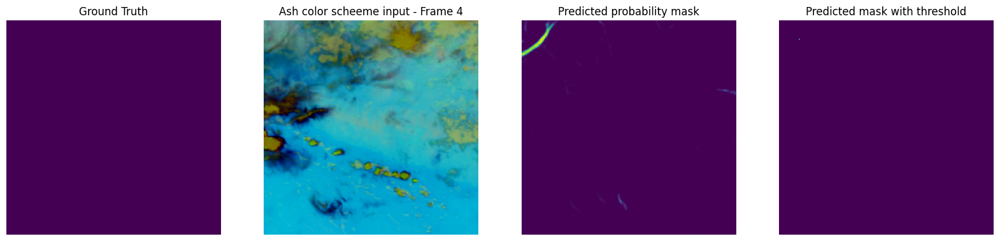

Saved plot: plot_output PureBaseline/batch_2_img_4.png


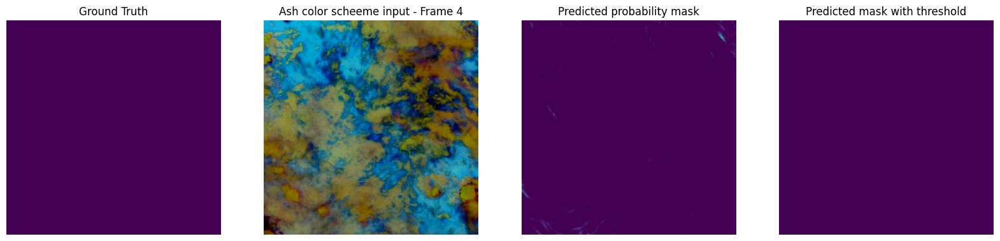

Saved plot: plot_output PureBaseline/batch_2_img_5.png


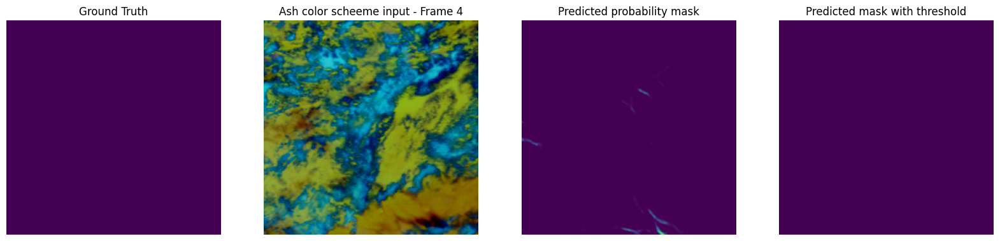

Saved plot: plot_output PureBaseline/batch_2_img_6.png


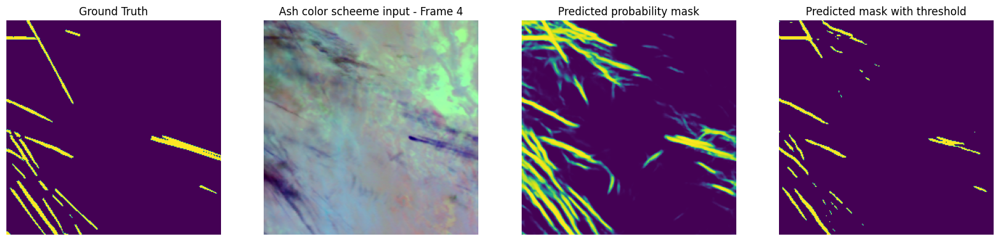

Saved plot: plot_output PureBaseline/batch_2_img_7.png


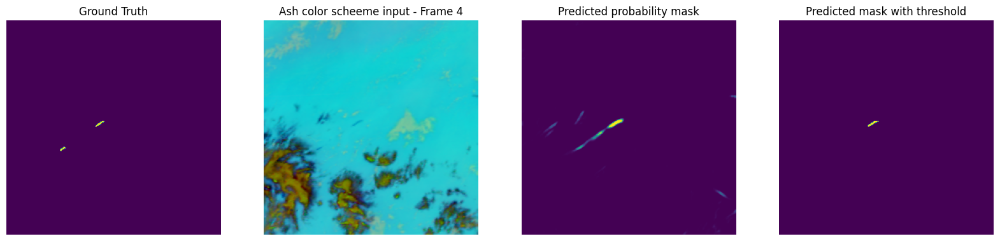

Saved plot: plot_output PureBaseline/batch_2_img_8.png


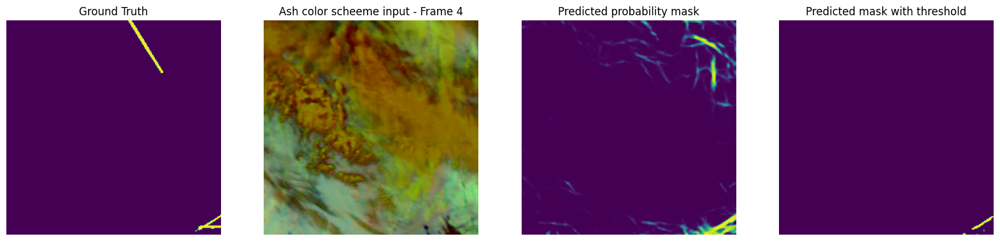

Saved plot: plot_output PureBaseline/batch_2_img_9.png


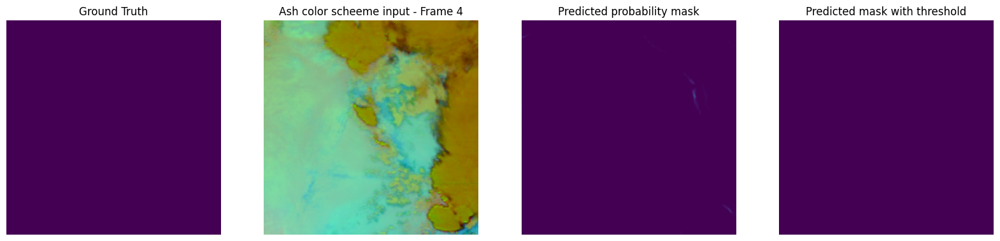

Saved plot: plot_output PureBaseline/batch_2_img_10.png


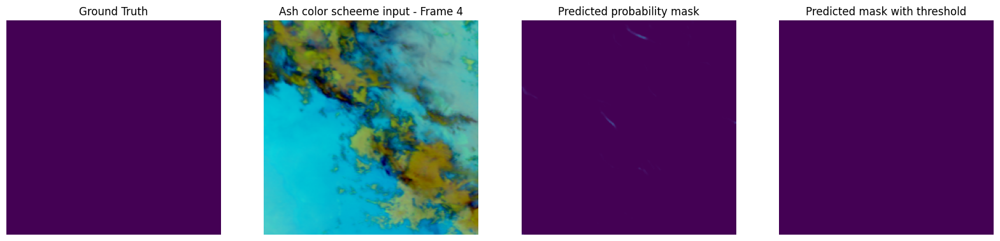

Saved plot: plot_output PureBaseline/batch_2_img_11.png


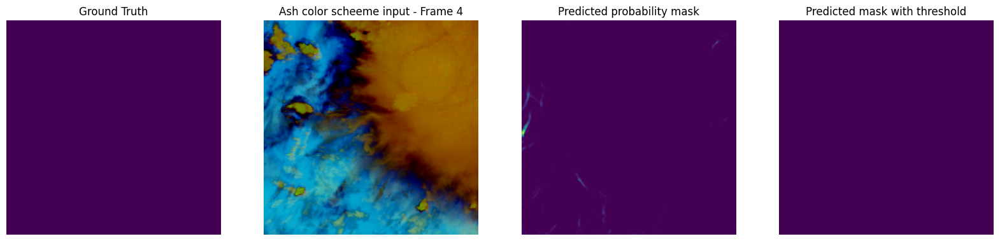

Saved plot: plot_output PureBaseline/batch_2_img_12.png


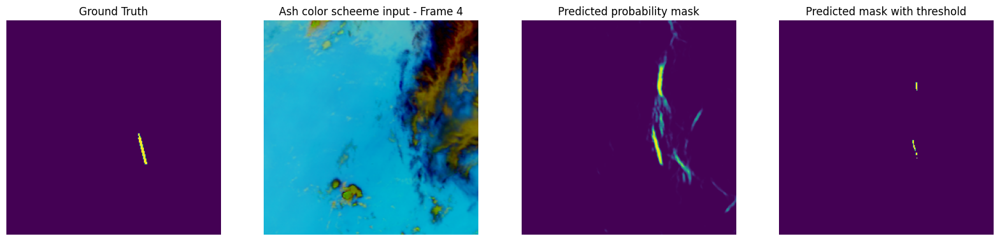

Saved plot: plot_output PureBaseline/batch_2_img_13.png


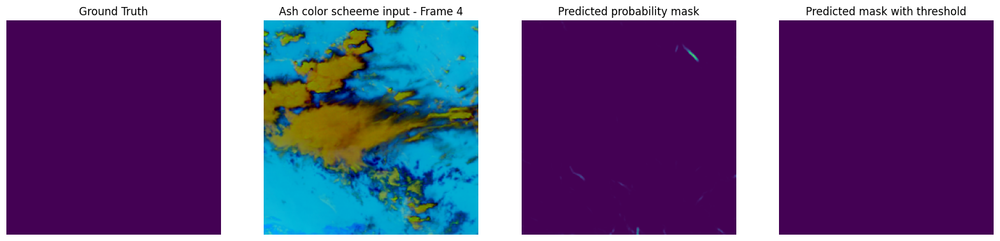

Saved plot: plot_output PureBaseline/batch_2_img_14.png


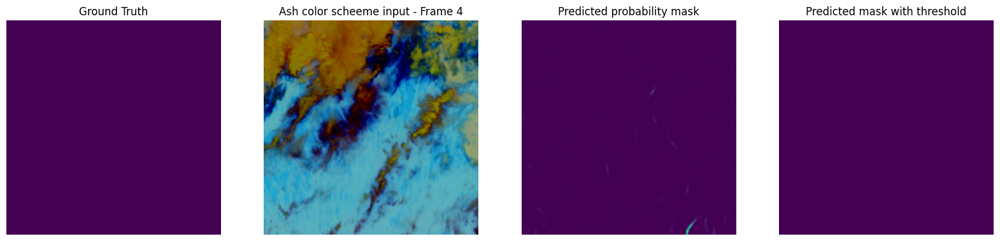

Saved plot: plot_output PureBaseline/batch_2_img_15.png


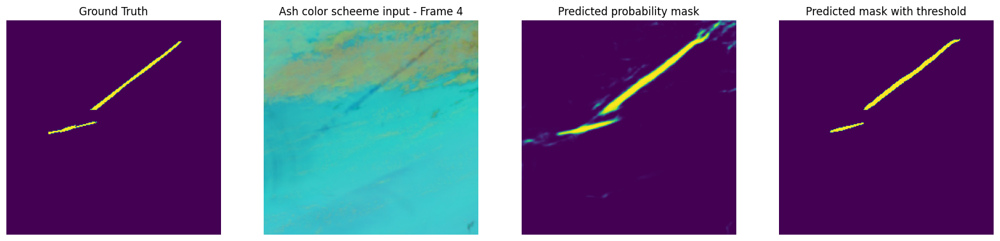

Saved plot: plot_output PureBaseline/batch_2_img_16.png


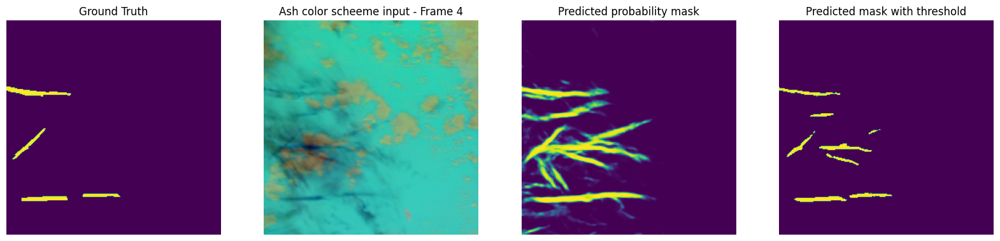

Saved plot: plot_output PureBaseline/batch_3_img_1.png


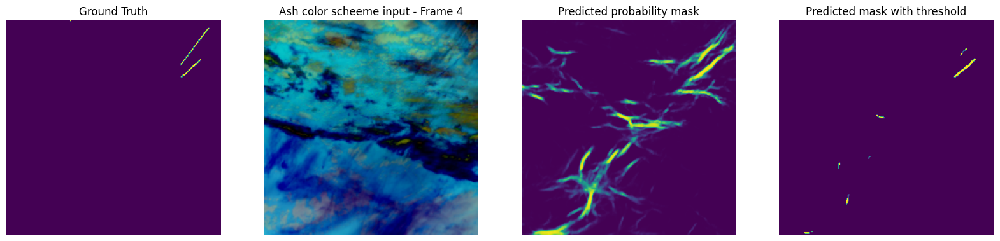

Saved plot: plot_output PureBaseline/batch_3_img_2.png


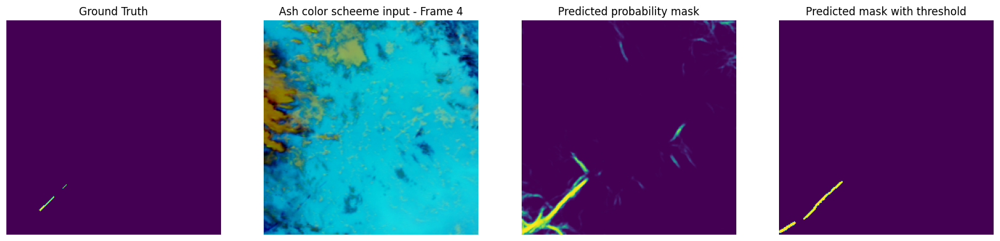

Saved plot: plot_output PureBaseline/batch_3_img_3.png


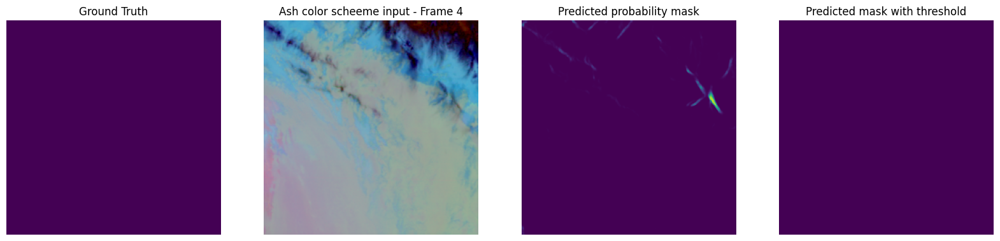

Saved plot: plot_output PureBaseline/batch_3_img_4.png


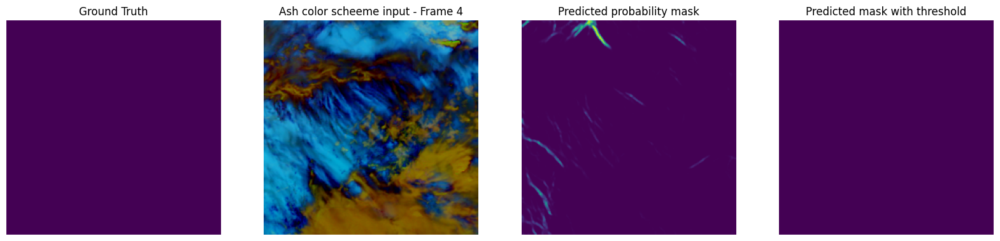

Saved plot: plot_output PureBaseline/batch_3_img_5.png


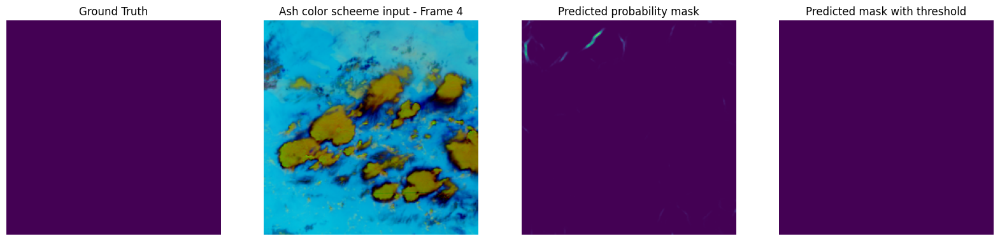

Saved plot: plot_output PureBaseline/batch_3_img_6.png


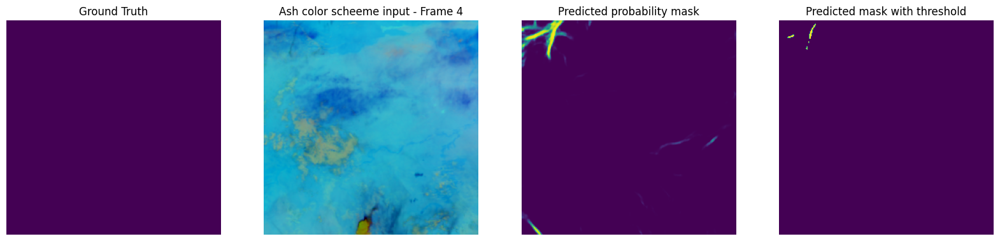

Saved plot: plot_output PureBaseline/batch_3_img_7.png


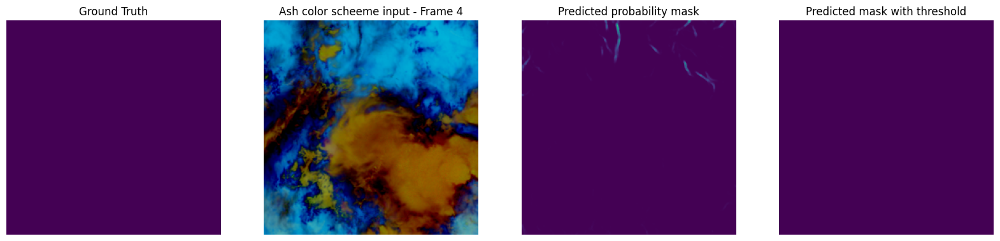

Saved plot: plot_output PureBaseline/batch_3_img_8.png


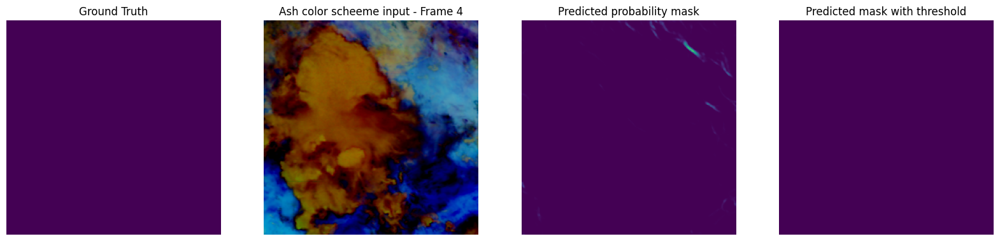

Saved plot: plot_output PureBaseline/batch_3_img_9.png


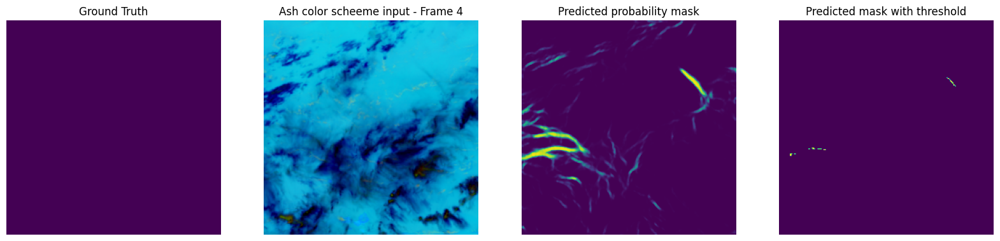

Saved plot: plot_output PureBaseline/batch_3_img_10.png


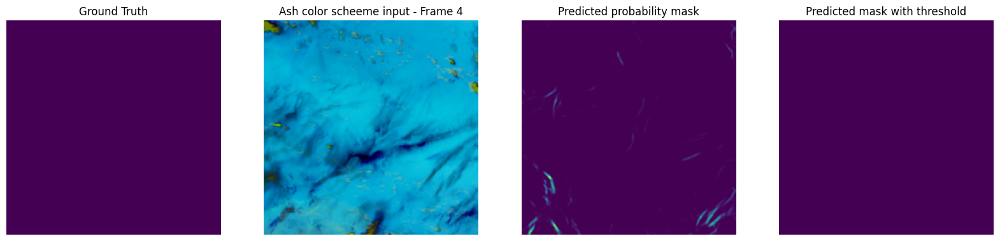

Saved plot: plot_output PureBaseline/batch_3_img_11.png


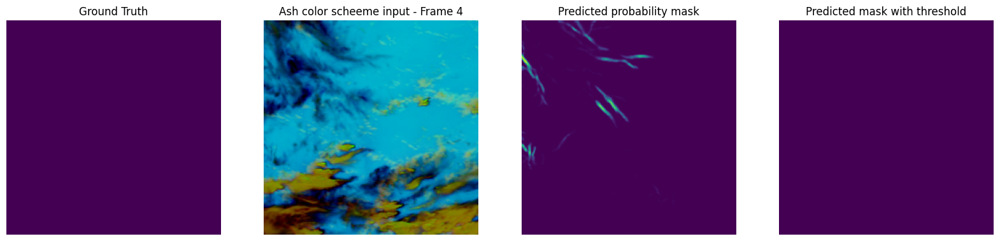

Saved plot: plot_output PureBaseline/batch_3_img_12.png


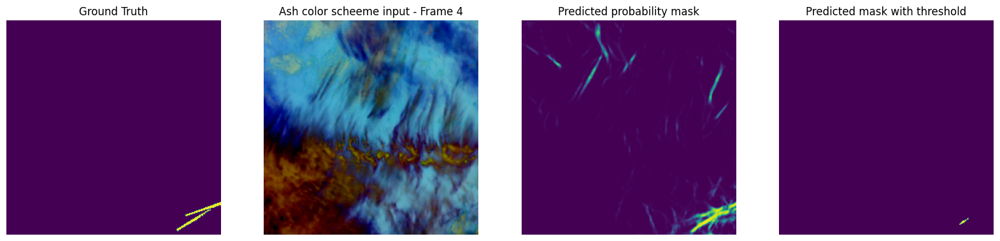

Saved plot: plot_output PureBaseline/batch_3_img_13.png


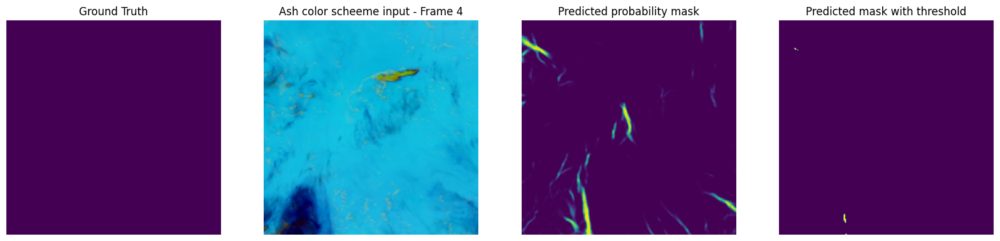

Saved plot: plot_output PureBaseline/batch_3_img_14.png


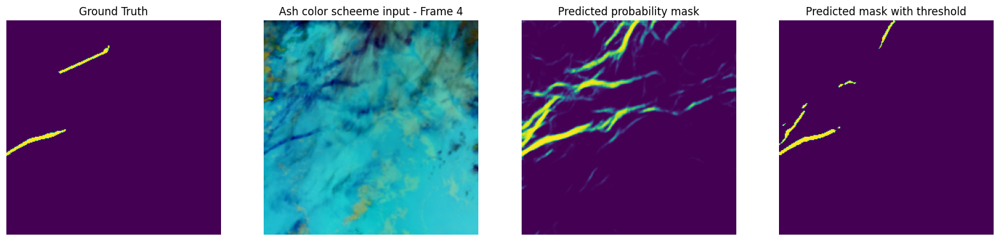

Saved plot: plot_output PureBaseline/batch_3_img_15.png


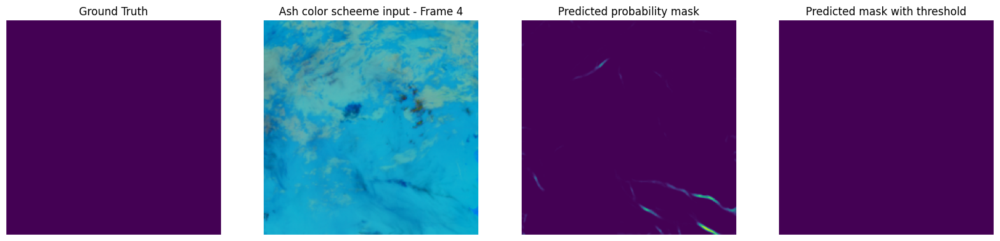

Saved plot: plot_output PureBaseline/batch_3_img_16.png


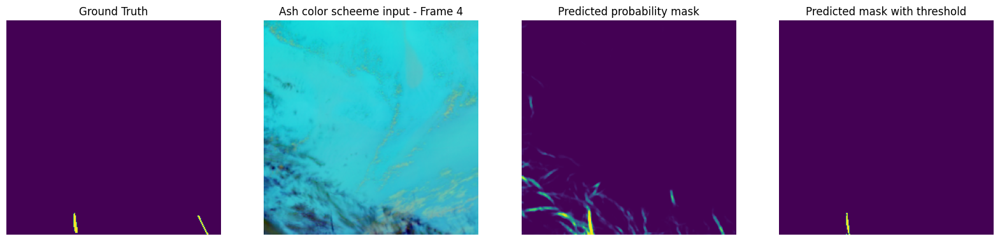

Saved plot: plot_output PureBaseline/batch_4_img_1.png


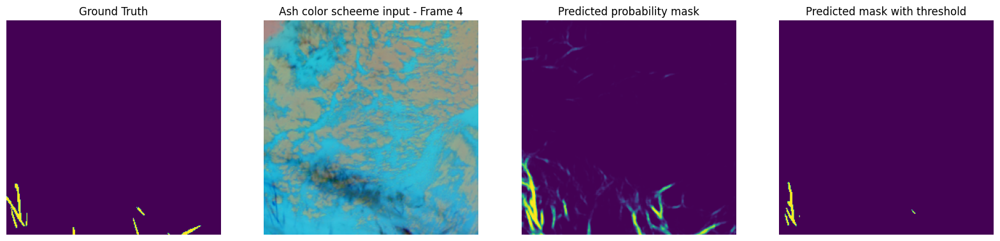

Saved plot: plot_output PureBaseline/batch_4_img_2.png


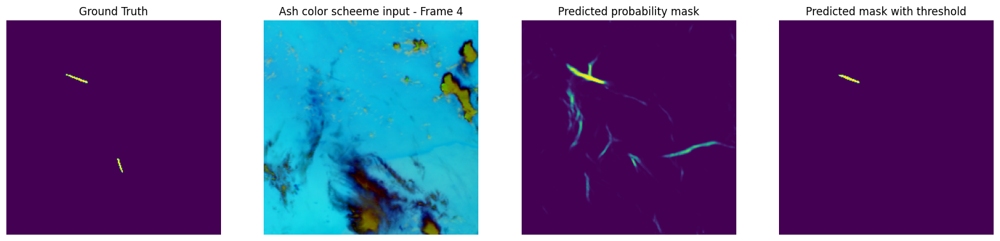

Saved plot: plot_output PureBaseline/batch_4_img_3.png


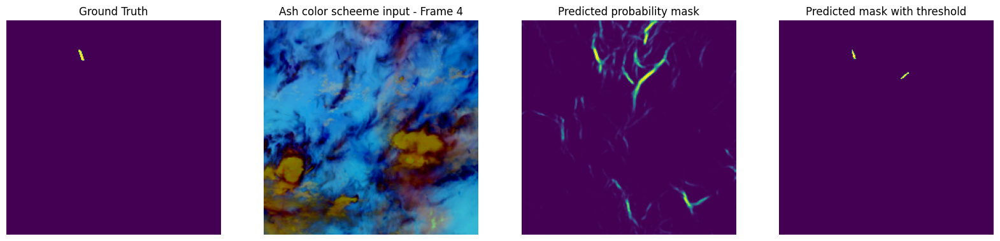

Saved plot: plot_output PureBaseline/batch_4_img_4.png


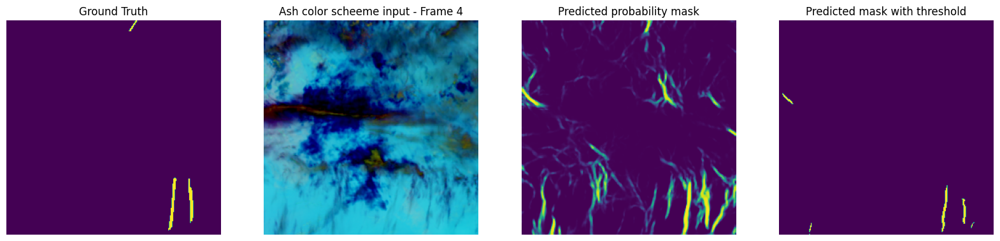

Saved plot: plot_output PureBaseline/batch_4_img_5.png


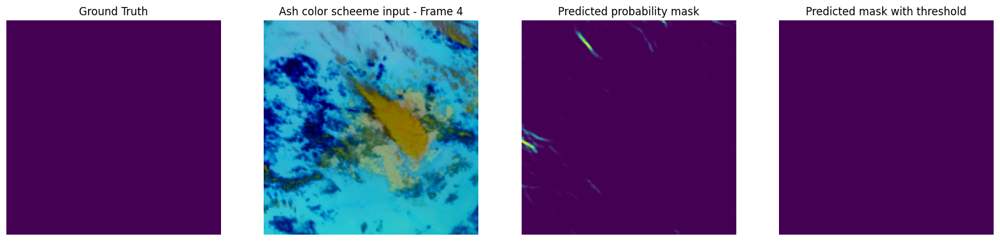

Saved plot: plot_output PureBaseline/batch_4_img_6.png


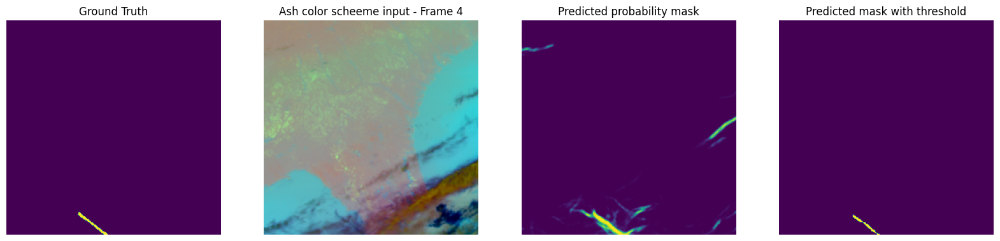

Saved plot: plot_output PureBaseline/batch_4_img_7.png


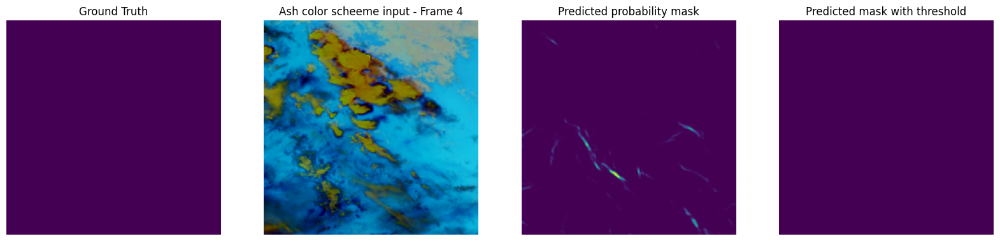

Saved plot: plot_output PureBaseline/batch_4_img_8.png


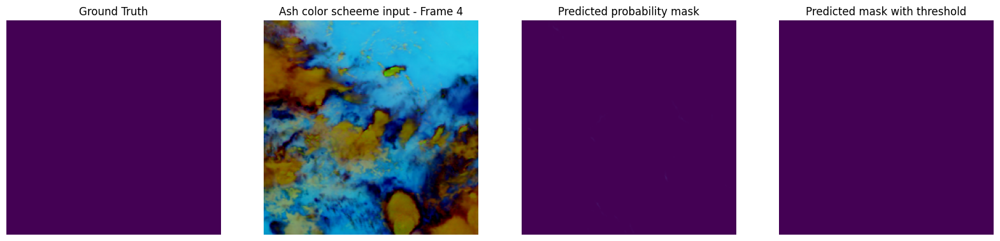

Saved plot: plot_output PureBaseline/batch_4_img_9.png


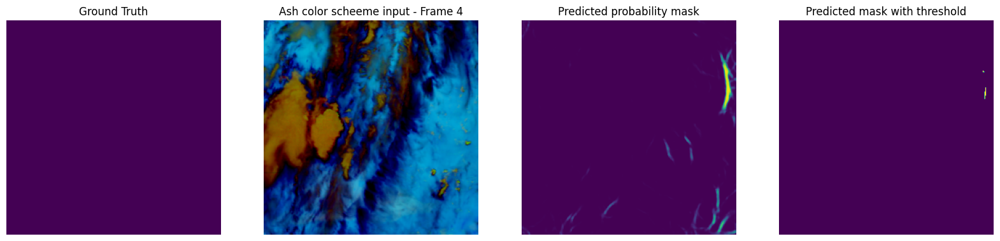

Saved plot: plot_output PureBaseline/batch_4_img_10.png


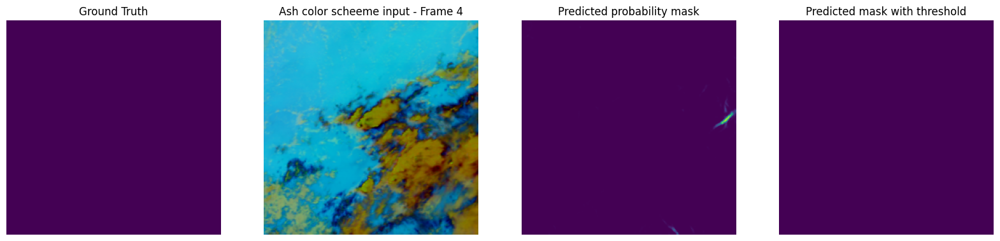

Saved plot: plot_output PureBaseline/batch_4_img_11.png


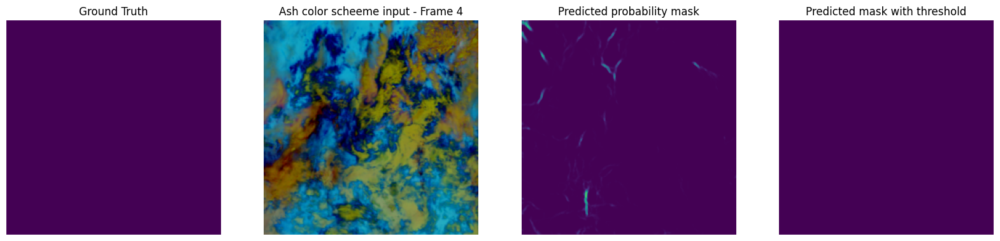

Saved plot: plot_output PureBaseline/batch_4_img_12.png


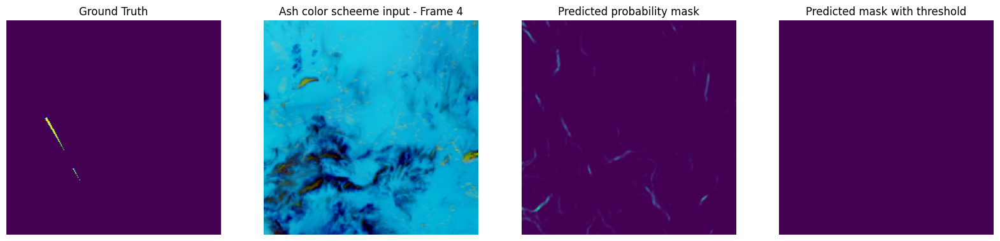

Saved plot: plot_output PureBaseline/batch_4_img_13.png


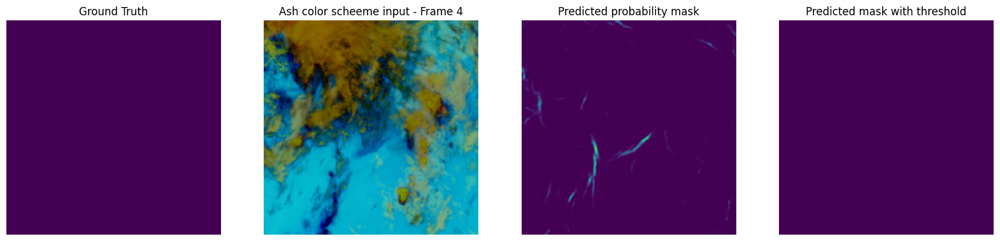

Saved plot: plot_output PureBaseline/batch_4_img_14.png


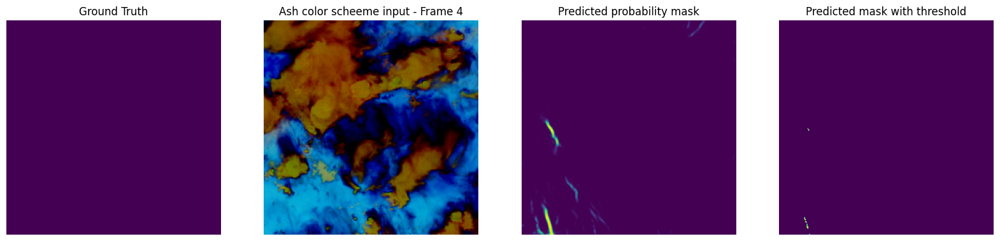

Saved plot: plot_output PureBaseline/batch_4_img_15.png


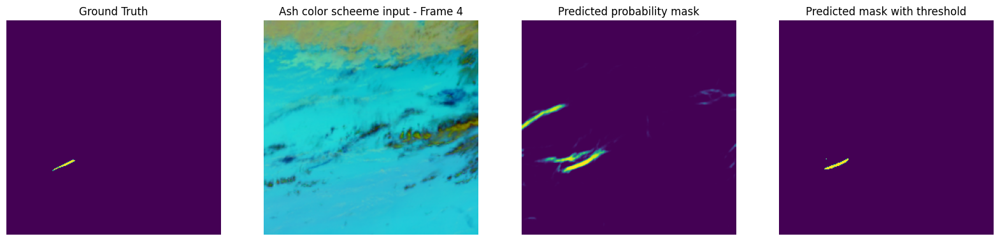

Saved plot: plot_output PureBaseline/batch_4_img_16.png


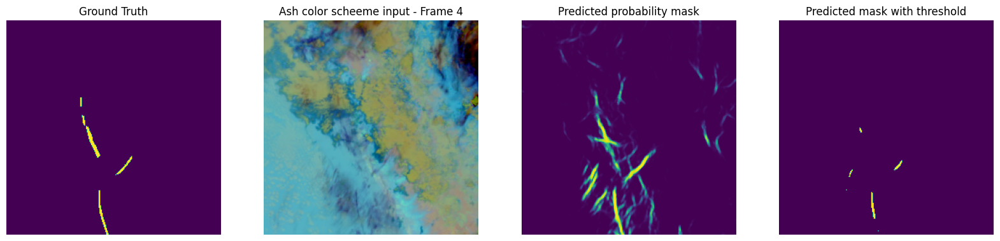

In [32]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

batches_to_show = 4
model.eval()

for i, data in enumerate(data_loader_validation):
    images, mask = data
    
    # Predict mask for this instance
    if torch.cuda.is_available():
        images = images.cuda()
    predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
    # Apply threshold
    predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
    images = images.cpu()
        
    for img_num in range(0, images.shape[0]):
        fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,10))
        axes = axes.flatten()
        
        # Show groud trought 
        axes[0].imshow(mask[img_num, 0, :, :])
        axes[0].axis('off')
        axes[0].set_title('Ground Truth')
        
        # Show ash color scheme input image
        axes[1].imshow( np.concatenate(
            (
            np.expand_dims(images[img_num, 4, :, :], axis=2),
            np.expand_dims(images[img_num, 12, :, :], axis=2),
            np.expand_dims(images[img_num, 20, :, :], axis=2)
        ), axis=2))
        axes[1].axis('off')
        axes[1].set_title('Ash color scheeme input - Frame 4')

        # Show predicted mask
        axes[2].imshow(predicated_mask[img_num, 0, :, :], vmin=0, vmax=1)
        axes[2].axis('off')
        axes[2].set_title('Predicted probability mask')

        # Show predicted mask after threshold
        axes[3].imshow(predicated_mask_with_threshold[img_num, :, :])
        axes[3].axis('off')
        axes[3].set_title('Predicted mask with threshold')

        output_dir = "plot_output PureBaseline"
        os.makedirs(output_dir, exist_ok=True)

        # Save the plot
        plot_filename = os.path.join(output_dir, f"batch_{i+1}_img_{img_num+1}.png")
        plt.savefig(plot_filename)
        print(f"Saved plot: {plot_filename}")    

        
        plt.show()
    
    if i + 1 >= batches_to_show:
        break